In [1]:
import scanpy as scp
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import scipy as sp
import pandas as pd
from umap.umap_ import UMAP

import sys
sys.path.append('../')
from mySCfunctions import *
from silent import *
sys.path.append('../')

import Parameters as par
from importlib import reload
reload(par);

from umap.umap_ import UMAP

import warnings
warnings.filterwarnings('ignore')

# Load the data

For most part el the following analysis, we do not further need the Corrected nor normalized data. We hence return to our Quality Control data and use the uploaded PCsmatrix for clustering purposes.

In [2]:
a8_5 = scp.read("ManipulatedData/"+METRIC+"/BatchCorrected/Stage/BatchCorrecteStage_E8.5.h5ad")
a8_5.var.set_index("Gene",inplace=True)
#a8_0 = scp.read("ManipulatedData/"+METRIC+"/BatchCorrected/Stage/BatchCorrecteStage_E8.0.h5ad")
#a7_5 = scp.read("ManipulatedData/"+METRIC+"/BatchCorrected/Stage/BatchCorrecteStage_E7.5.h5ad")

In [3]:
geneList = [
 'Cdh1','Dmrt2','Egr2','En1','Eya1','Foxa2','Foxd1','Foxf1','Foxf2','Foxp2','Hand1',
 'Hand2','Hoxa1','Hoxa2','Hoxa3','Hoxa4','Hoxa10','Isl1','Lefty1','Lfng','Lhx1','Meox1','Mesp1','Mesp2','Myf5','Nkx2-5','Noto',
 'Olig2','Osr1','Otx2','Pax1','Pax3','Pax6','Pitx2','Ripply2','Six1','Sox1','Sox2','Sox9','Sox17','T','Tbx1','Tbx4','Tbx5',
 'Tbx6','Tcf15','Twist1','Twist2','Uncx','Wnt1'
]

print(len(geneList), " genes: ",np.sort(geneList))

50  genes:  ['Cdh1' 'Dmrt2' 'Egr2' 'En1' 'Eya1' 'Foxa2' 'Foxd1' 'Foxf1' 'Foxf2'
 'Foxp2' 'Hand1' 'Hand2' 'Hoxa1' 'Hoxa10' 'Hoxa2' 'Hoxa3' 'Hoxa4' 'Isl1'
 'Lefty1' 'Lfng' 'Lhx1' 'Meox1' 'Mesp1' 'Mesp2' 'Myf5' 'Nkx2-5' 'Noto'
 'Olig2' 'Osr1' 'Otx2' 'Pax1' 'Pax3' 'Pax6' 'Pitx2' 'Ripply2' 'Six1'
 'Sox1' 'Sox17' 'Sox2' 'Sox9' 'T' 'Tbx1' 'Tbx4' 'Tbx5' 'Tbx6' 'Tcf15'
 'Twist1' 'Twist2' 'Uncx' 'Wnt1']


In [30]:
# Genes a segmentar
genes = ["Tcf15","Isl1","Pitx2","Ripply2","Tbx6","L15fng","Pitx2","Pax3","Tbx1","Meox1","Uncx","Pax1",
"Myf5","Foxd1","Dmrt2","Eya1","Six1","T"]

In [6]:
marker_genes = {
    "presomitic": {"Tbx6"},
    "boundary_somitic_presomitic": {"Ripply2"},
    "somitic_mesoderm": {"Uncx","Pax1","Pax3"}, # Pax3 Expressed in Neural crest too
    "somitic_presomitic_mesoderm": {"Tsf15","Meox1"},
    "muscle_precursor": {"Myf5","Meox"},
    "sclerotome": {"Pax1"}, #Bones...
    "head_mesoderm": {"Tbx1","Tcf21","Msc"},
    "heart": {"Nkx2-5","Tbx5"},
    "notochord":{"Noto"}
}

# Gene expression 7.5

We show the expression in the Harmony corrected UMAP of the relevant genes given by Alfonso.

In [7]:
a = a7_5

<AxesSubplot:ylabel='Count'>

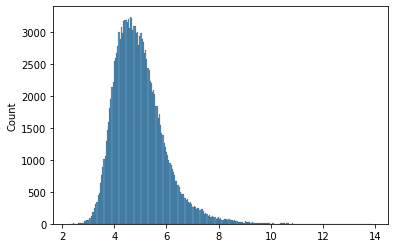

In [8]:
scp.pp.neighbors(a,use_rep="X_pca_harmony",n_neighbors=15,metric=metric,n_pcs=50)
distances = np.array(a.uns["neighbors"]["distances"][a.uns["neighbors"]["distances"].nonzero()])[0]
sb.histplot(distances)

In [9]:
flexible_neighbors(a, 7)
a.obs["flexible_neighbors_cluster_size"].value_counts()

6952    6952
2146    2146
1864    1864
1         81
2         10
4          4
Name: flexible_neighbors_cluster_size, dtype: int64

In [10]:
a = a[a.obs["flexible_neighbors_cluster_size"]>15]

In [11]:
model = UMAP(metric=metric,n_neighbors=10,min_dist=0.5,random_state=1,disconnection_distance=7)
a.obsm["X_umap_harmony"] = model.fit_transform(a.obsm["X_pca_harmony"])

Text(0.5, 1.0, 'Foxf2')

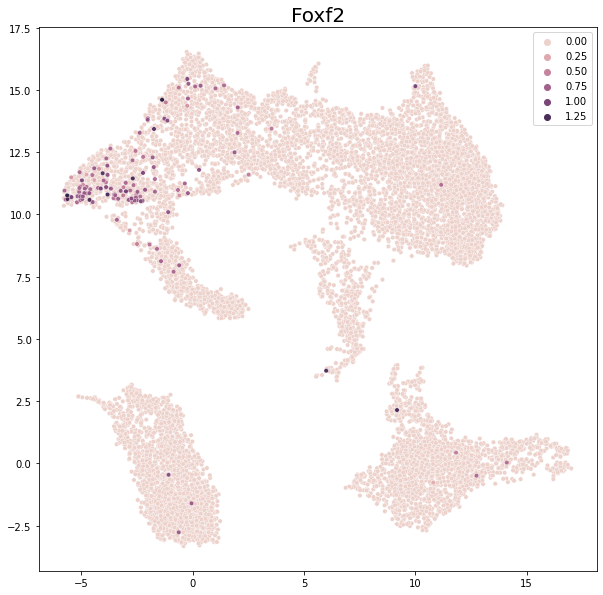

In [12]:
g = "Foxf2"

fig,ax=plt.subplots(1,1,figsize=[10,10])
hue = np.log1p(a.obsm["raw"][:,a.var["Gene"]==g].toarray().reshape(-1))
    
pos = np.argsort(hue)
#print(geneList[k], hue.shape)
sb.scatterplot(a.obsm["X_umap_harmony"][pos,0],a.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=20,ax=ax)
ax.set_title(g,fontsize=20)

In [13]:
# Noto se relaciona sobre si el corazón se sitúa a la derecha o izquierda. (Asociado con Nodal)

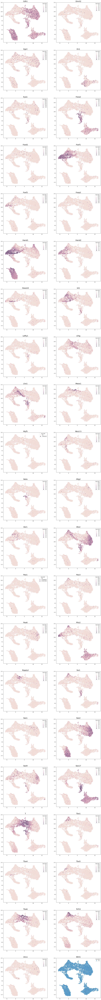

In [14]:
x1 = 2
x2 = 21

fig,ax=plt.subplots(x2,x1,figsize=[20,210])
for k in range(42):
    
    j = k%x1
    i = k//x1
    
    hue = np.log1p(a.obsm["raw"][:,a.var["Gene"]==geneList[k]].toarray().reshape(-1))
    
    pos = np.argsort(hue)
    #print(geneList[k], hue.shape)
    sb.scatterplot(a.obsm["X_umap_harmony"][pos,0],a.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=20,ax=ax[i,j])
    ax[i,j].set_title(geneList[k],fontsize=20)
    ax[i,j].legend(title="Log scale",title_fontsize=10,fontsize=10)
    
fig.savefig("Genes_umap_E7.5.png")

# Gene expression 8.0

We show the expression in the Harmony corrected UMAP of the relevant genes given by Alfonso.

In [15]:
a = a8_0

<AxesSubplot:ylabel='Count'>

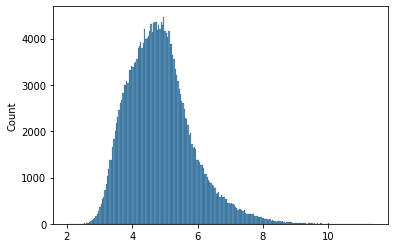

In [16]:
scp.pp.neighbors(a,use_rep="X_pca_harmony",n_neighbors=15,metric=metric,n_pcs=50)
distances = np.array(a.uns["neighbors"]["distances"][a.uns["neighbors"]["distances"].nonzero()])[0]
sb.histplot(distances)

In [17]:
flexible_neighbors(a, 7)
a.obs["flexible_neighbors_cluster_size"].value_counts()

15510    15510
1694      1694
981        981
1           97
2           14
Name: flexible_neighbors_cluster_size, dtype: int64

In [18]:
a = a[a.obs["flexible_neighbors_cluster_size"]>15]

In [19]:
model = UMAP(metric=metric,n_neighbors=10,min_dist=0.5,random_state=1,disconnection_distance=7)
a.obsm["X_umap_harmony"] = model.fit_transform(a.obsm["X_pca_harmony"])

Text(0.5, 1.0, 'Foxf2')

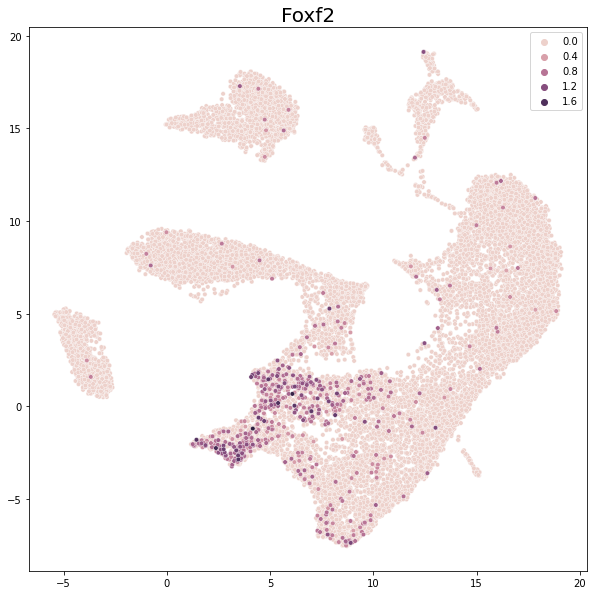

In [20]:
g = "Foxf2"

fig,ax=plt.subplots(1,1,figsize=[10,10])
hue = np.log1p(a.obsm["raw"][:,a.var["Gene"]==g].toarray().reshape(-1))
    
pos = np.argsort(hue)
#print(geneList[k], hue.shape)
sb.scatterplot(a.obsm["X_umap_harmony"][pos,0],a.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=20,ax=ax)
ax.set_title(g,fontsize=20)

In [21]:
# Noto se relaciona sobre si el corazón se sitúa a la derecha o izquierda. (Asociado con Nodal)

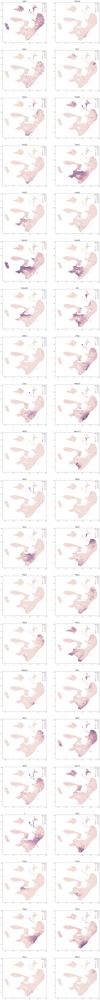

In [22]:
x1 = 2
x2 = 21

fig,ax=plt.subplots(x2,x1,figsize=[20,210])
for k in range(42):
    
    j = k%x1
    i = k//x1
    
    hue = np.log1p(a.obsm["raw"][:,a.var["Gene"]==geneList[k]].toarray().reshape(-1))
    
    pos = np.argsort(hue)
    #print(geneList[k], hue.shape)
    sb.scatterplot(a.obsm["X_umap_harmony"][pos,0],a.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=20,ax=ax[i,j])
    ax[i,j].set_title(geneList[k],fontsize=20)
    ax[i,j].legend(title="Log scale",title_fontsize=10,fontsize=10)
    
fig.savefig("Genes_umap_E8.0.jpg",bbox_inches="tight")

# 8.5

We show the expression in the Harmony corrected UMAP of the relevant genes given by Alfonso.

In [4]:
path = "Plots/E8_5/"

In [5]:
a = a8_5

<AxesSubplot:ylabel='Count'>

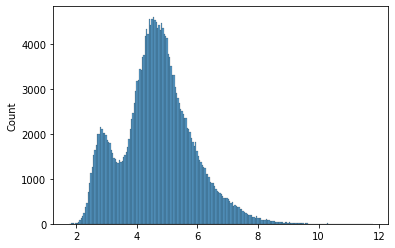

In [6]:
scp.pp.neighbors(a,use_rep="X_pca_harmony",n_neighbors=N_NEIGBOURS,metric=METRIC,n_pcs=N_PCS)
distances = np.array(a.uns["neighbors"]["distances"][a.uns["neighbors"]["distances"].nonzero()])[0]
sb.histplot(distances)

In [7]:
flexible_neighbors(a, DISCONNECTION_DISTANCE)
a.obs["flexible_neighbors_cluster_size"].value_counts()

16671    16671
678        678
1          102
14          14
2            4
Name: flexible_neighbors_cluster_size, dtype: int64

In [8]:
a = a[a.obs["flexible_neighbors_cluster_size"]>15]

In [9]:
model = UMAP(metric=METRIC,n_neighbors=10,min_dist=0.5,random_state=1,disconnection_distance=DISCONNECTION_DISTANCE)
a.obsm["X_umap_harmony"] = model.fit_transform(a.obsm["X_pca_harmony"])

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


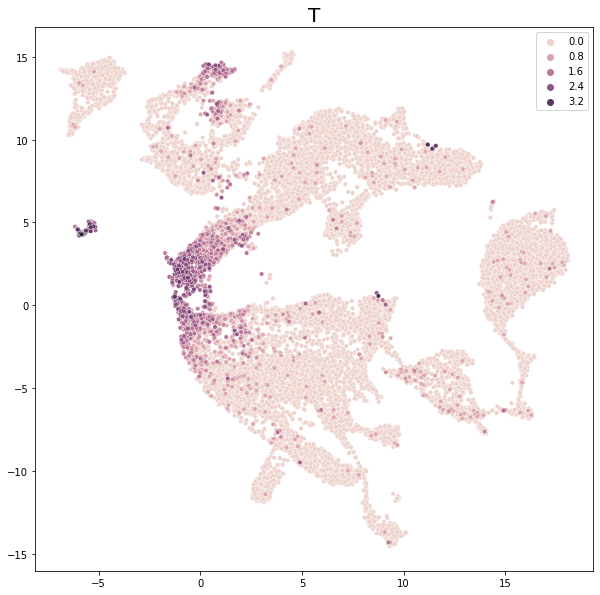

In [10]:
g = "T"

fig,ax=plt.subplots(1,1,figsize=[10,10])
hue = np.log1p(a.obsm["raw"][:,a.var.index==g].toarray().reshape(-1))
    
pos = np.argsort(hue)
#print(geneList[k], hue.shape)
sb.scatterplot(a.obsm["X_umap_harmony"][pos,0],a.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=20,ax=ax)
ax.set_title(g,fontsize=20)

fig.savefig(path+"/Genes/"+str(g)+".png")
fig.show()

## Clustering

In [40]:
scp.tl.louvain(a,adjacency=a.obsp["connectivities_flexible"],resolution=0.5,key_added="louvain_harmony")

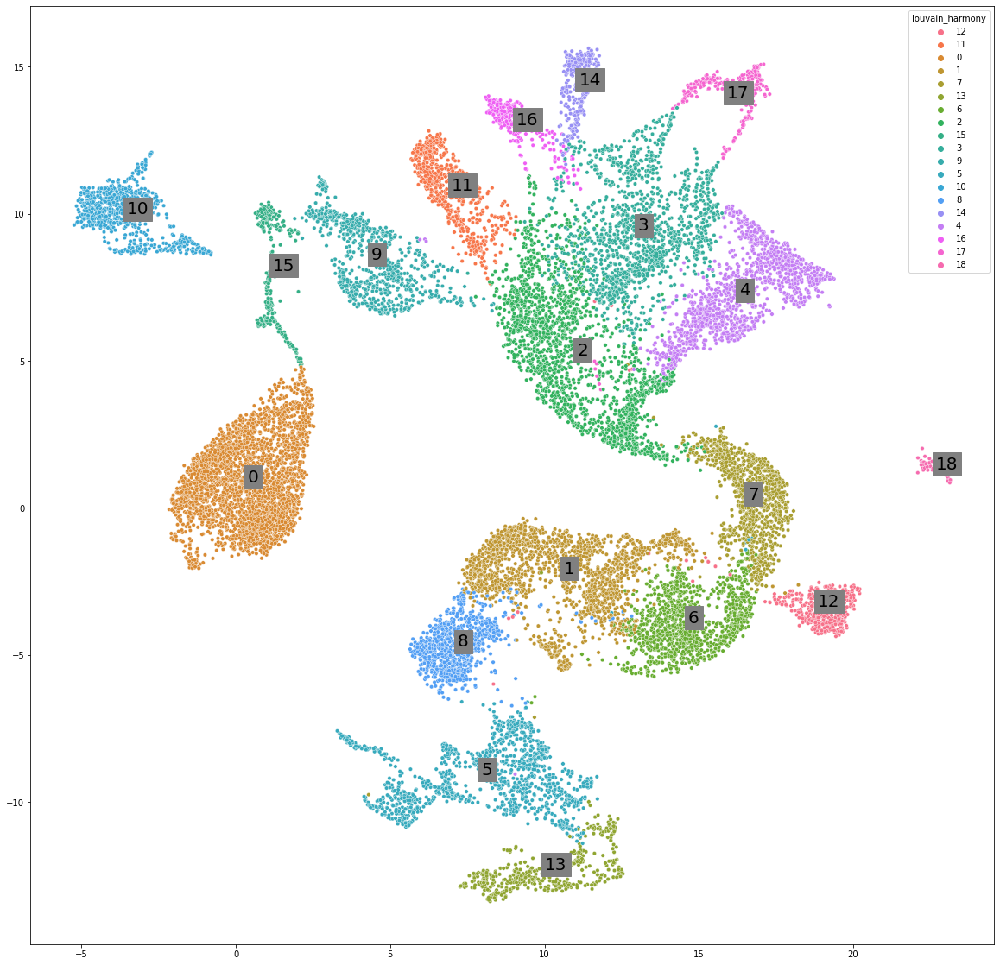

In [41]:
fig,ax = plt.subplots(1,1,figsize=[20,20])

a.obs["louvain_harmony"]=a.obs["louvain_harmony"].astype(str)
sb.scatterplot(x=a.obsm["X_umap_harmony"][:,0],y=a.obsm["X_umap_harmony"][:,1],hue=a.obs["louvain_harmony"],s=20,ax=ax)
for i in a.obs["louvain_harmony"].unique():
    pos = a[a.obs["louvain_harmony"]==i,:].obsm["X_umap_harmony"]
    pos = np.nan_to_num(pos)
    pos = pos.mean(axis=0)
    ax.text(pos[0],pos[1],i,fontsize=20,backgroundcolor="grey")
    
fig.savefig(path+"Clustering.png")

## DE Genes 

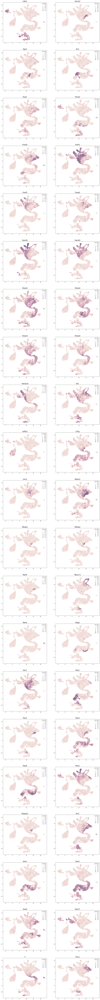

In [38]:
x1 = 2
x2 = 21

fig,ax=plt.subplots(x2,x1,figsize=[20,210])
for k in range(42):
    
    j = k%x1
    i = k//x1
    
    hue = np.log1p(a.obsm["raw"][:,a.var.index==geneList[k]].toarray().reshape(-1))
    
    pos = np.argsort(hue)
    #print(geneList[k], hue.shape)
    sb.scatterplot(a.obsm["X_umap_harmony"][pos,0],a.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=20,ax=ax[i,j])
    ax[i,j].set_title(geneList[k],fontsize=20)
    ax[i,j].legend(title="Log scale",title_fontsize=10,fontsize=10)
    
fig.savefig(path+"Genes_umap.jpg",bbox_inches="tight")

## DE Expression

In [34]:
scp.tl.rank_genes_groups(a,use_raw="raw",groupby="louvain_harmony",method="wilcoxon")

... storing 'louvain_harmony' as categorical


In [35]:
l = pd.DataFrame()

for i in range(40):
    l[i] = a.var.loc[list(a.uns["rank_genes_groups"]["names"][i]),"Gene"].values
    
l.index = ["Group "+str(i) for i in range(a.obs["louvain_harmony"].unique().astype(int).max()+1)]

l.to_html(path+"DEGenes.html")

## Marker genes expression by cluster

In [36]:
b = a.obs.copy()
for i in geneList:
    b[i]=a.X[:,a.var.loc[:,"Gene"]==i].todense()

m = b.groupby("louvain_harmony").agg({i:["mean"] for i in geneList})
m.columns = [i[0] for i in m.columns]

m = m.round(1)
m.index = m.index.astype(int)
m = m.sort_index()

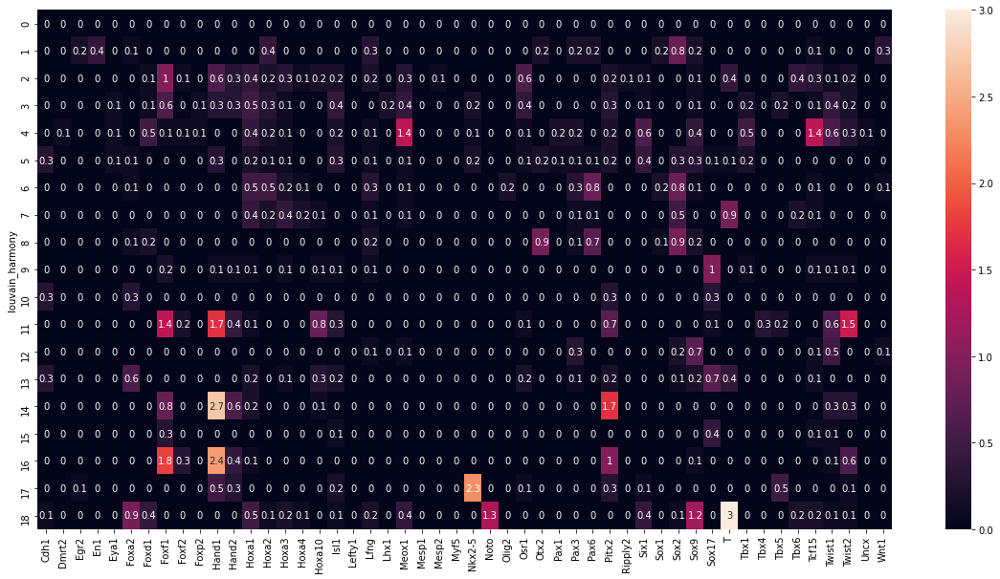

In [37]:
fig,ax = plt.subplots(1,1,figsize=(20,10))
sb.heatmap(m,annot=True)

fig.savefig(path+"MeanExpression.jpg")

## Annotations

In [40]:
annotations8_5={
 0:"Hematpoiesis",
 1:"Midbrain/hindbrain",
 2:"Lateral Plate Mesoderm",
 3:"Intermediate Mesoderm",
 4:"Somitogenesis and paraxial mesoderm",
 5:"Anterior endoderm",
 6:"Spinal Cord",
 7:"Caudal epiblast",
 8:"Forebrain",
 9:"Yolk sac blood",
 10:"Endoderm",
 11:"Allantois",
 12:"Blood progenitors",
 13:"Pharyngeal arches",
 14:"Myofibroblasts I",
 15:"Erythropoiesis",
 16:"Myofibroblasts II",
 17:"First and Second heart fields",
 18:"Node"
}

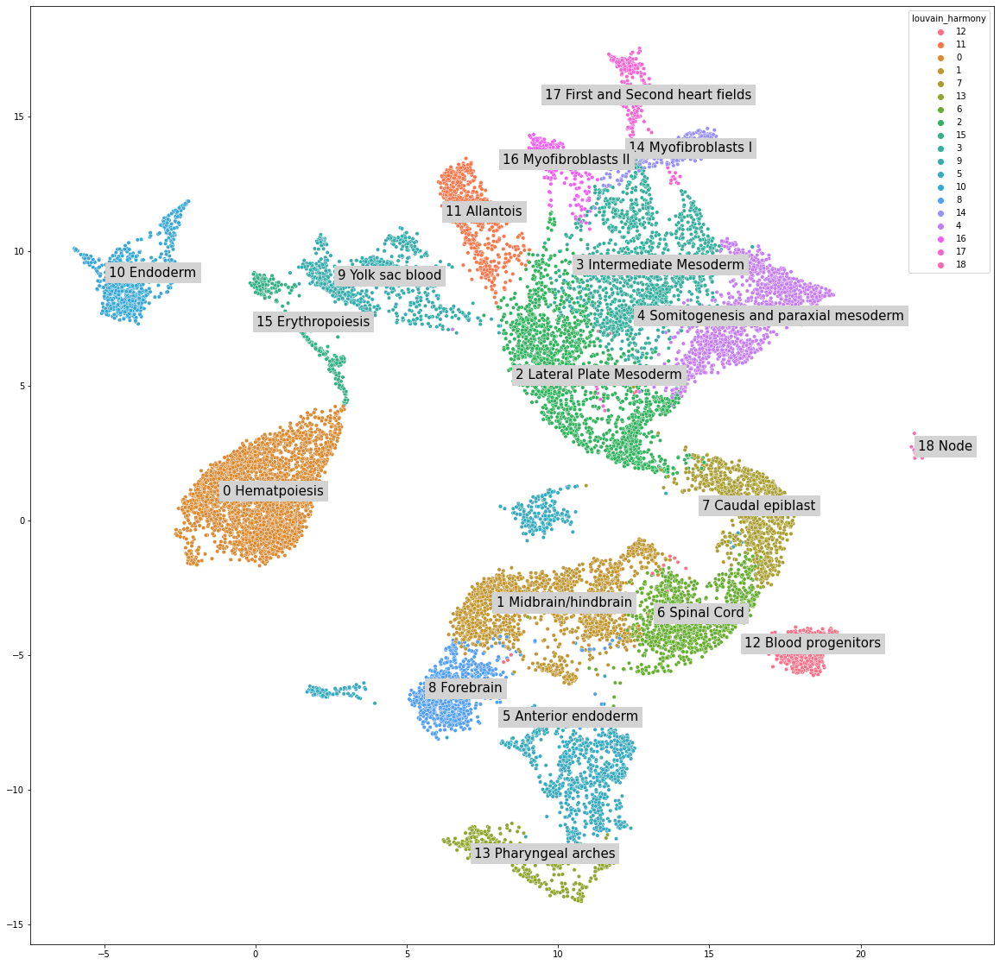

In [41]:
fig,ax = plt.subplots(1,1,figsize=[20,20])

a.obs["louvain_harmony"]=a.obs["louvain_harmony"].astype(str)
sb.scatterplot(x=a.obsm["X_umap_harmony"][:,0],y=a.obsm["X_umap_harmony"][:,1],hue=a.obs["louvain_harmony"],s=20,ax=ax)
for i in a.obs["louvain_harmony"].unique():
    pos = a[a.obs["louvain_harmony"]==i,:].obsm["X_umap_harmony"]
    pos = np.nan_to_num(pos)
    pos = pos.mean(axis=0)
    ax.text(pos[0]-0.2*0.5*len(annotations8_5[int(i)]),
            pos[1],
            i+" "+annotations8_5[int(i)],
            fontsize=15,
            backgroundcolor="lightgrey")
    
fig.savefig(path+"ClusteringAnnotated.png")

## Subclustering 4

In [40]:
subpath = path+"Subcluster_4/"

In [41]:
b = a[a.obs["louvain_harmony"]=="4"]

scp.pp.neighbors(b,use_rep="X_pca_harmony")

In [45]:
b.obsm["X_umap_harmony"] = model.fit_transform(b.obsm["X_pca_harmony"])

In [46]:
scp.tl.louvain(b,key_added="louvain",resolution=0.7)

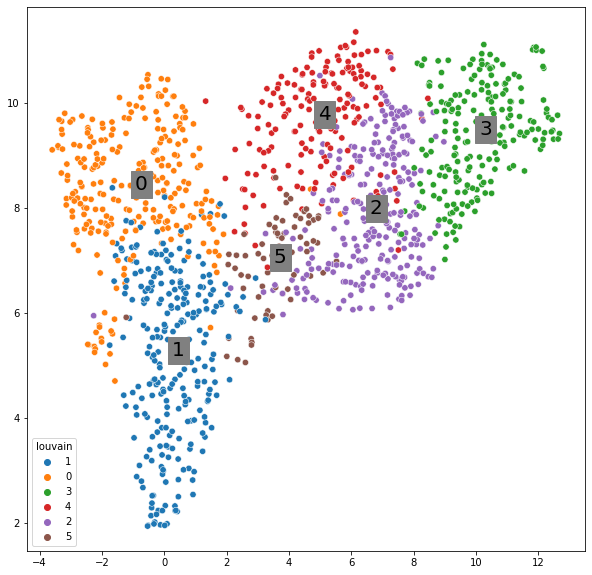

In [47]:
fig,ax = plt.subplots(1,1,figsize=[10,10])

b.obs["louvain"]=b.obs["louvain"].astype(str)
sb.scatterplot(x=b.obsm["X_umap_harmony"][:,0],y=b.obsm["X_umap_harmony"][:,1],hue=b.obs["louvain"],s=40,ax=ax)
for i in b.obs["louvain"].unique():
    pos = b[b.obs["louvain"]==i,:].obsm["X_umap_harmony"]
    pos = np.nan_to_num(pos)
    pos = pos.mean(axis=0)
    ax.text(pos[0],pos[1],i,fontsize=20,backgroundcolor="grey")
    
#ax.axis([12,20,-6,0])
    
fig.savefig(subpath+"Clustering.jpg")

### Gene expression

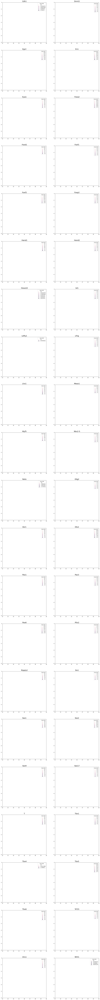

In [83]:
x1 = 2
x2 = 21

fig,ax=plt.subplots(x2,x1,figsize=[20,210])
for k in range(42):
    
    j = k%x1
    i = k//x1
    
    hue = np.log1p(b.obsm["raw"][:,b.var["Gene"]==geneList[k]].toarray().reshape(-1))
    
    pos = np.argsort(hue)
    #print(geneList[k], hue.shape)
    sb.scatterplot(b.obsm["X_umap_harmony"][pos,0],b.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=40,ax=ax[i,j])
    ax[i,j].set_title(geneList[k],fontsize=20)
    ax[i,j].legend(title="Log scale",title_fontsize=10,fontsize=10)
    
    ax[i,j].axis([12,20,-6,0])
    
fig.savefig(subpath+"Genes_umap.jpg",bbox_inches="tight")

### Marker genes expression by cluster

In [84]:
c = b.obs.copy()
for i in geneList:
    c[i]=b.X[:,b.var.loc[:,"Gene"]==i].todense()

m = c.groupby("louvain").agg({i:["mean"] for i in geneList})
m.columns = [i[0] for i in m.columns]

m = m.round(1)
m.index = m.index.astype(int)
m = m.sort_index()

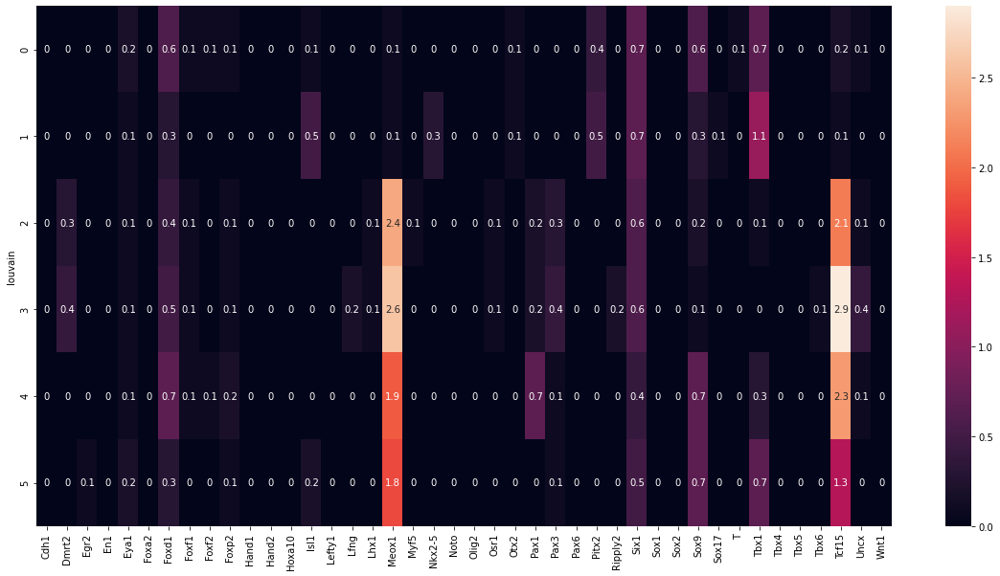

In [85]:
fig,ax = plt.subplots(1,1,figsize=(20,10))
sb.heatmap(m,annot=True)

fig.savefig(subpath+"MeanExpression.jpg")

### DE Genes

In [86]:
scp.pp.filter_genes(b,min_cells=1)
scp.tl.rank_genes_groups(b,use_raw="raw",groupby="louvain",method="wilcoxon")

l = pd.DataFrame()

for i in range(40):
    l[i] = b.var.loc[list(b.uns["rank_genes_groups"]["names"][i]),"Gene"].values
    
l.index = ["Group "+str(i) for i in range(b.obs["louvain"].unique().astype(int).max()+1)]

l.to_html(subpath+"DEGenes.html")

... storing 'louvain' as categorical
... storing 'louvain_harmony' as categorical


## Subclustering 2,3,4

In [42]:
subpath = path + "Subcluster_2_3_4/"

In [43]:
clusters = (a.obs["louvain_harmony"]=="2")+(a.obs["louvain_harmony"]=="3")+(a.obs["louvain_harmony"]=="4")
b = a[clusters]

scp.pp.neighbors(b,use_rep="X_pca_harmony")

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [44]:
b.obsm["X_umap_harmony"] = model.fit_transform(b.obsm["X_pca_harmony"])

In [45]:
scp.tl.louvain(b,key_added="louvain",resolution=1)

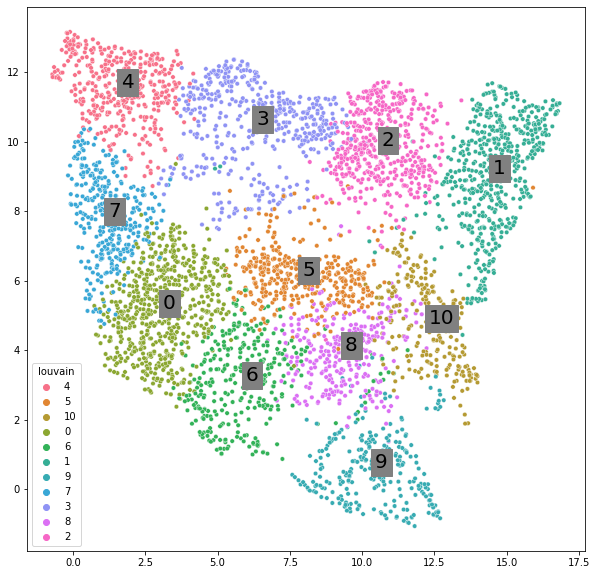

In [46]:
fig,ax = plt.subplots(1,1,figsize=[10,10])

b.obs["louvain"]=b.obs["louvain"].astype(str)
sb.scatterplot(x=b.obsm["X_umap_harmony"][:,0],y=b.obsm["X_umap_harmony"][:,1],hue=b.obs["louvain"],s=20,ax=ax)
for i in b.obs["louvain"].unique():
    pos = b[b.obs["louvain"]==i,:].obsm["X_umap_harmony"]
    pos = np.nan_to_num(pos)
    pos = pos.mean(axis=0)
    ax.text(pos[0],pos[1],i,fontsize=20,backgroundcolor="grey")
    
    
#ax.axis([6,20,-10,3])

fig.savefig(subpath+"Clustering.png",bbox_inches="tight",transparent=False)

### 1D Projection

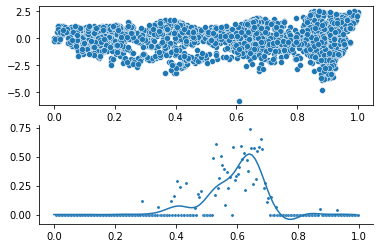

In [62]:
adata = b
clusters_ref = "louvain"
clusters = ["4","3","2","1"]
map_ref = "X_umap_harmony"

x,y = linearize_UMAP(adata,clusters_ref,clusters,map_ref,regress=False)

fig,ax = plt.subplots(2,1)


#for i in clusters:
    
sb.scatterplot(x,y,ax=ax[0])

for i in ["Pax1"]:
    plot_scatter_expression(x,adata,i,ax=ax[1],bins=200,clusters_ref=clusters_ref,clusters=clusters
                                ,s=10)
    plot_line_expression(x,adata,i,ax=ax[1],clusters_ref=clusters_ref,clusters=clusters)

ax[1].spines["top"].set_visible(False)
ax[1].spines["right"].set_visible(False)

fig.show()

### Paga

In [29]:
scp.tl.paga(b,groups="louvain")

... storing 'louvain' as categorical
... storing 'louvain_harmony' as categorical


In [ ]:
fig,ax = plt.subplots(1,1,figsize=[10,10])

b.obs["louvain"]=b.obs["louvain"].astype(str)
sb.scatterplot(x=b.obsm["X_umap_harmony"][:,0],y=b.obsm["X_umap_harmony"][:,1],hue=b.obs["louvain"],s=20,ax=ax)
for i in b.obs["louvain"].unique():
    pos = b[b.obs["louvain"]==i,:].obsm["X_umap_harmony"]
    pos = np.nan_to_num(pos)
    pos = pos.mean(axis=0)
    ax.text(pos[0],pos[1],i,fontsize=20,backgroundcolor="grey")
    

#ax.axis([6,20,-10,3])

fig.savefig(subpath+"Clustering.png",bbox_inches="tight",transparent=False)

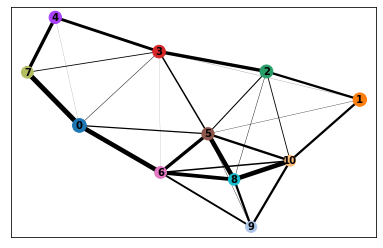

In [39]:
scp.pl.paga(b)

### Gene expression

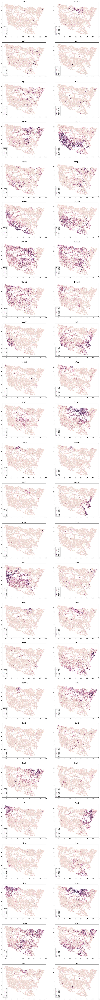

In [35]:
x1 = 2
x2 = 25

fig,ax=plt.subplots(x2,x1,figsize=[20,210])
for k in range(50):
    
    j = k%x1
    i = k//x1
    
    hue = np.log1p(b.obsm["raw"][:,b.var["Gene"]==geneList[k]].toarray().reshape(-1))
    
    pos = np.argsort(hue)
    #print(geneList[k], hue.shape)
    sb.scatterplot(b.obsm["X_umap_harmony"][pos,0],b.obsm["X_umap_harmony"][pos,1],
                   hue=hue[pos],
                   s=40,ax=ax[i,j])
    ax[i,j].set_title(geneList[k],fontsize=20)
    ax[i,j].legend(title="Log scale",title_fontsize=10,fontsize=10)
    
#    ax[i,j].axis([6,20,-10,3])
    
fig.savefig(subpath+"Genes_umap.jpg",bbox_inches="tight")

### Marker genes expression by cluster

In [93]:
c = b.obs.copy()
for i in geneList:
    c[i]=b.X[:,b.var.loc[:,"Gene"]==i].todense()

m = c.groupby("louvain").agg({i:["mean"] for i in geneList})
m.columns = [i[0] for i in m.columns]

m = m.round(1)
m.index = m.index.astype(int)
m = m.sort_index()

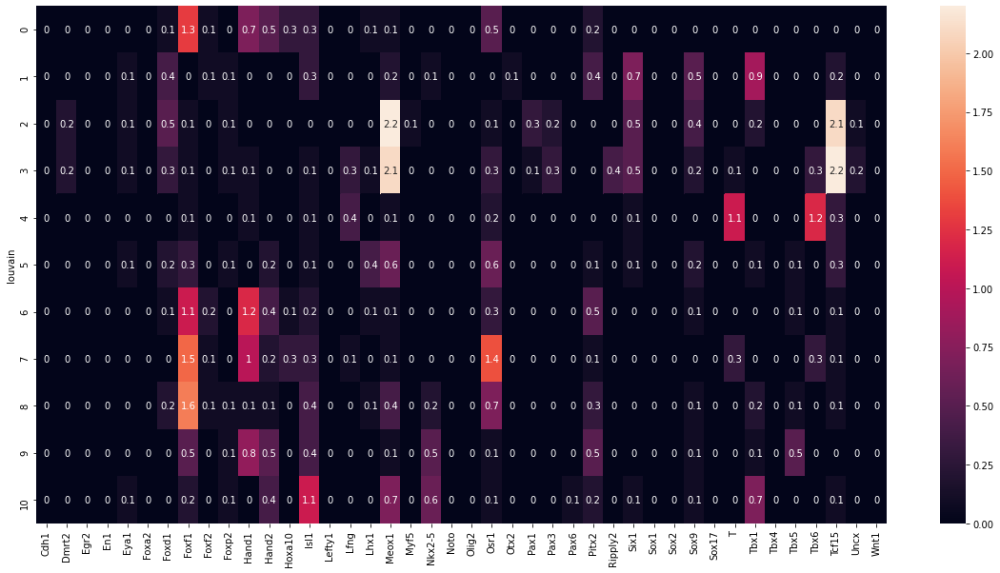

In [94]:
fig,ax = plt.subplots(1,1,figsize=(20,10))
sb.heatmap(m,annot=True)

fig.savefig(subpath+"MeanExpression.jpg")

### DE Genes

In [95]:
scp.pp.filter_genes(b,min_cells=1)
scp.tl.rank_genes_groups(b,use_raw="raw",groupby="louvain",method="wilcoxon")

l = pd.DataFrame()

for i in range(40):
    l[i] = b.var.loc[list(b.uns["rank_genes_groups"]["names"][i]),"Gene"].values
    
l.index = ["Group "+str(i) for i in range(b.obs["louvain"].unique().astype(int).max()+1)]

l.to_html(subpath+"DEGenes.html")

... storing 'louvain' as categorical
... storing 'louvain_harmony' as categorical


# Supplementary: Comparison between batch correction algorithms at clustering

In [ ]:
scp.tl.louvain(a,adjacency=a.obsp["harmony_connectivities"],resolution=1,key_added="louvain_harmony")
scp.tl.louvain(a,adjacency=a.obsp["MNN_connectivities"],resolution=1,key_added="louvain_MNN")

In [ ]:
fig,ax = plt.subplots(1,2,figsize=[20,10])

a.obs["louvain_harmony"]=a.obs["louvain_harmony"].astype(str)
sb.scatterplot(x=a.obsm["X_umap_harmony"][:,0],y=a.obsm["X_umap_harmony"][:,1],hue=a.obs["louvain_harmony"],s=20,ax=ax[0])

a.obs["louvain_MNN"]=a.obs["louvain_MNN"].astype(str)
sb.scatterplot(x=a.obsm["X_umap_MNN"][:,0],y=a.obsm["X_umap_MNN"][:,1],hue=a.obs["louvain_MNN"],s=20,ax=ax[1])

In [ ]:
plot_cluster_overlap(a,"louvain_harmony","louvain_MNN",r=1)

# Supplementary comparison between metrics

In [282]:
acosine = scp.read("./Data_manipulated/"+"cosine"+"/BatchCorrected/Stage/BatchCorrecteStage_E8.5.h5ad")
aeuclidiean = scp.read("./Data_manipulated/"+"euclidean"+"/BatchCorrected/Stage/BatchCorrecteStage_E8.5.h5ad")
amanhattan = scp.read("./Data_manipulated/"+"manhattan"+"/BatchCorrected/Stage/BatchCorrecteStage_E8.5.h5ad")

In [283]:
scp.pp.neighbors(acosine,metric="cosine")
flexible_neighbors(acosine,0.25)

In [285]:
scp.pp.neighbors(aeuclidiean,metric="euclidean")
flexible_neighbors(aeuclidiean,7.5)

In [291]:
scp.pp.neighbors(amanhattan,metric="manhattan")
flexible_neighbors(amanhattan,40)

In [295]:
cellsCosine = acosine.obs[acosine.obs["flexible_neighbors_cluster_size"]>20].index
cellsEuclidean = aeuclidiean.obs[aeuclidiean.obs["flexible_neighbors_cluster_size"]>20].index
cellsManhattan = amanhattan.obs[amanhattan.obs["flexible_neighbors_cluster_size"]>20].index

In [308]:
cells = [cellsCosine,cellsEuclidean,cellsManhattan]
m = np.zeros([3,3])
for i in range(len(cells)):
    for j in range(len(cells)):
        m[i,j] = len([k for k in cells[i] if k in cells[j]])/len(cells[i])

There is an almost perfect overlap

<AxesSubplot:>

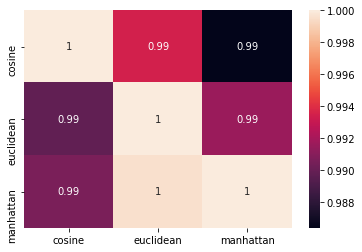

In [312]:
sb.heatmap(m,xticklabels=["cosine","euclidean","manhattan"],yticklabels=["cosine","euclidean","manhattan"],annot=True)

In [366]:
scp.tl.louvain(acosine,adjacency=acosine.obsp["harmony_connectivities"],resolution=0.3,key_added="louvain_harmony")
acosine.obs["louvain_harmony"].unique()

['11', '10', '0', '1', '2', ..., '8', '9', '6', '12', '13']
Length: 14
Categories (14, object): ['11', '10', '0', '1', ..., '9', '6', '12', '13']

In [367]:
scp.tl.louvain(aeuclidiean,adjacency=aeuclidiean.obsp["harmony_connectivities"],resolution=0.3,key_added="louvain_harmony")
aeuclidiean.obs["louvain_harmony"].unique()

['10', '9', '0', '1', '3', ..., '8', '7', '11', '12', '13']
Length: 14
Categories (14, object): ['10', '9', '0', '1', ..., '7', '11', '12', '13']

In [368]:
scp.tl.louvain(amanhattan,adjacency=amanhattan.obsp["harmony_connectivities"],resolution=0.3,key_added="louvain_harmony")
amanhattan.obs["louvain_harmony"].unique()

['12', '11', '0', '3', '7', ..., '10', '9', '6', '13', '14']
Length: 15
Categories (15, object): ['12', '11', '0', '3', ..., '9', '6', '13', '14']

In [369]:
cellsCommon = [i for i in cellsCosine if (i in cellsEuclidean) and (i in cellsManhattan)]

In [370]:
aCommon = acosine[cellsCommon].copy()

In [371]:
aCommon.obs["louvain_cosine"] = aCommon.obs["louvain_harmony"]
aCommon.obs["louvain_euclidean"] = aeuclidiean.obs.loc[cellsCommon,"louvain_harmony"]
aCommon.obs["louvain_manhattan"] = amanhattan.obs.loc[cellsCommon,"louvain_harmony"]

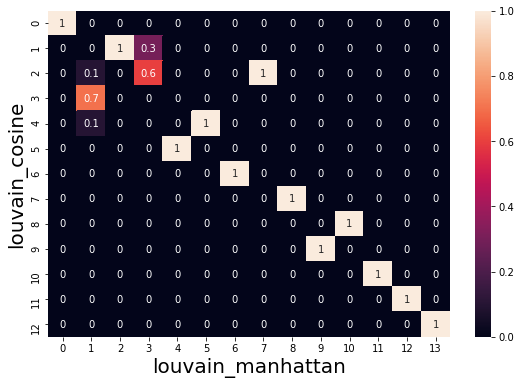

In [372]:
plot_cluster_overlap(aCommon,"louvain_manhattan","louvain_cosine",r=1)